## Notebook for novelty based segmentation tutorial from https://www.audiolabs-erlangen.de/resources/MIR/FMP/C4/C4S4_NoveltySegmentation.html

Novelty-based segmentation consists on applying a checkerboard kernel over a self-similarity matrix to compute a novelty curve. the peaks of the novelty curve signal a change on the audio

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from librosa.segment import cross_similarity
from librosa import stft, load, frames_to_time, clicks, time_to_frames, frames_to_samples
import librosa
from IPython.display import Audio, display
from scipy.signal import find_peaks
from scipy.spatial.distance import cosine
from scipy import signal

In [3]:
#compute similarity matrix
def compute_ssm(y, w_size):
    #compute stft with window size w_size and no overlapping segments
    fft = np.abs(stft(y,n_fft=w_size,hop_length=w_size)) #(freq_bins=nfft//2+1, frames)
    # img = librosa.display.specshow(librosa.amplitude_to_db(fft,ref=np.max), y_axis='log', x_axis='frames')
    # plt.show()
    
    #compute similarity matrix
    #ssm = cross_similarity(fft,fft, metric='cosine', mode='distance')
    
    X = fft.T #(frames, freq_bins)
    X_norm = X/(np.linalg.norm(X, axis=1, keepdims=True)+1e-9)
    
    ssm = np.dot(X_norm, X_norm.T)
    
    
    
    return ssm
    

In [4]:
def compute_kernel_checkerboard_gaussian(L, var=1, normalize=True):
    """Compute Guassian-like checkerboard kernel [FMP, Section 4.4.1].
    See also: https://scipython.com/blog/visualizing-the-bivariate-gaussian-distribution/

    Notebook: C4/C4S4_NoveltySegmentation.ipynb

    Args:
        L (int): Parameter specifying the kernel size M=2*L+1
        var (float): Variance parameter determing the tapering (epsilon) (Default value = 1.0)
        normalize (bool): Normalize kernel (Default value = True)

    Returns:
        kernel (np.ndarray): Kernel matrix of size M x M
    """
    taper = np.sqrt(1/2) / (L * var)
    axis = np.arange(-L, L+1)
    gaussian1D = np.exp(-taper**2 * (axis**2))
    gaussian2D = np.outer(gaussian1D, gaussian1D)
    kernel_box = np.outer(np.sign(axis), np.sign(axis))
    kernel = kernel_box * gaussian2D
    if normalize:
        kernel = kernel / np.sum(np.abs(kernel))
    return kernel

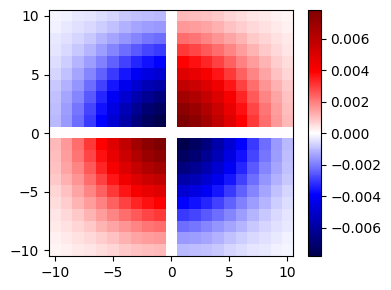

In [5]:
L = 10
var = 0.5
kernel = compute_kernel_checkerboard_gaussian(L, var)
plt.figure(figsize=(4,3))
plt.imshow(kernel, aspect='auto', origin='lower', 
           extent=[-L-0.5,L+0.5,-L-0.5,L+0.5], cmap='seismic')
plt.colorbar()
plt.tight_layout()

In [6]:
def compute_novelty_ssm(S, kernel=None, L=10, var=0.5, exclude=False):
    """Compute novelty function from SSM [FMP, Section 4.4.1]

    Notebook: C4/C4S4_NoveltySegmentation.ipynb

    Args:
        S (np.ndarray): SSM
        kernel (np.ndarray): Checkerboard kernel (if kernel==None, it will be computed) (Default value = None)
        L (int): Parameter specifying the kernel size M=2*L+1 (Default value = 10)
        var (float): Variance parameter determing the tapering (epsilon) (Default value = 0.5)
        exclude (bool): Sets the first L and last L values of novelty function to zero (Default value = False)

    Returns:
        nov (np.ndarray): Novelty function
    """
    if kernel is None:
        kernel = compute_kernel_checkerboard_gaussian(L=L, var=var)
    N = S.shape[0]
    M = 2*L + 1
    nov = np.zeros(N)
    # np.pad does not work with numba/jit
    S_padded = np.pad(S, L, mode='constant')

    for n in range(N):
        # Does not work with numba/jit
        nov[n] = np.sum(S_padded[n:n+M, n:n+M] * kernel)
    if exclude:
        right = np.min([L, N])
        left = np.max([0, N-L])
        nov[0:right] = 0
        nov[left:N] = 0

    return nov

In [49]:
#fname = "/data3/anasynth_nonbp/bujard/data/moisesdb_v2/train_subset/0d528a19-cb0f-4421-b250-444f9343e51c/guitar/guitar.wav"
#fname= "/data3/anasynth_nonbp/bujard/data/moisesdb_v2/train_subset/125fc63d-9b69-4170-a46a-42c91bc28446/vocals/vocals.wav"
fname="../../train_subset/014f3712-293b-42af-9f29-0ed1785be792/drums/drums.wav"
#fname="/data3/anasynth_nonbp/bujard/data/moisesdb_v2/train_subset/0358fd1e-244a-4422-9a42-29b5d68f6e4b/other_keys/other_keys.wav"
y, sr = load(fname,sr=None,mono=True,duration=60)
y = y/max(y)

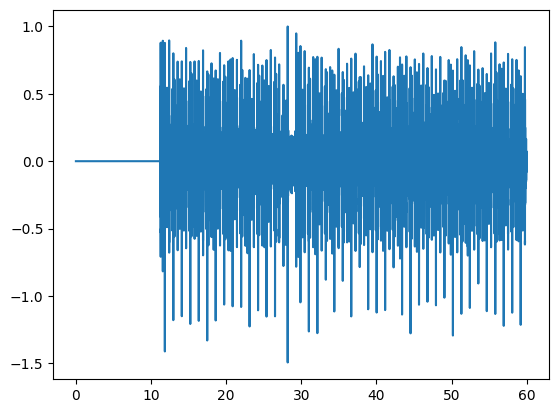

In [50]:
plt.plot(np.linspace(0,len(y)/sr,len(y)),y)
plt.show()

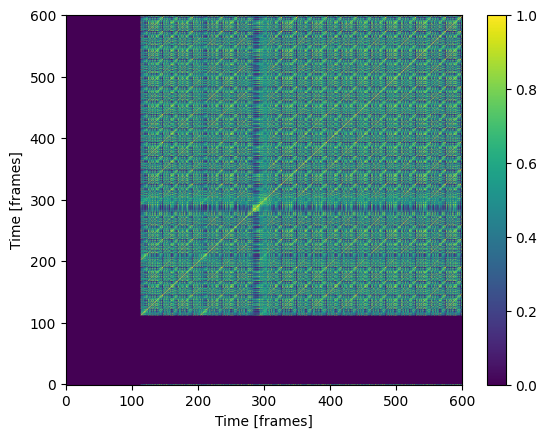

In [51]:
w_size = 0.1 #100ms
w_size = int(w_size*sr) #to samples
ssm = compute_ssm(y,w_size)

plt.imshow(ssm,aspect='auto', origin='lower')
plt.xlabel("Time [frames]")
plt.ylabel("Time [frames]")
plt.colorbar()
plt.show()
display(Audio(y,rate=sr))

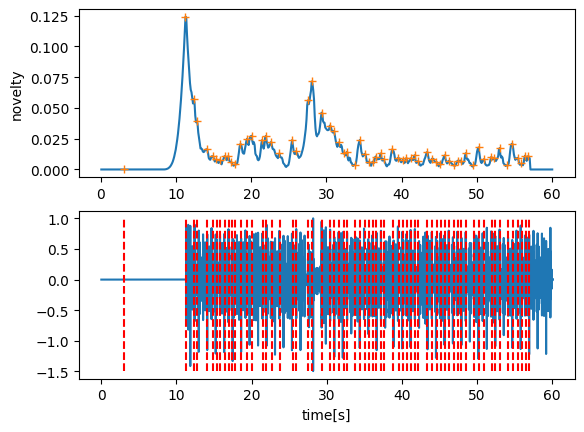

In [52]:
L_kernel = 30
nov = compute_novelty_ssm(ssm, L=L_kernel, exclude=True) 
t = frames_to_time(range(len(ssm)),sr=sr,hop_length=w_size,n_fft=w_size)

min_segment_duration = 0.5 #minimum sample length is 50ms
peaks, _ = find_peaks(nov, distance=time_to_frames(min_segment_duration,sr=sr,hop_length=w_size,n_fft=w_size))

plt.subplot(211)
plt.plot(t,nov)
plt.plot(t[peaks], nov[peaks], "+")
plt.ylabel("novelty")
plt.subplot(212)
plt.plot(np.linspace(0,len(y)/sr,len(y)),y)
plt.vlines(t[peaks],min(y),max(y),colors="r",linestyles="--")
plt.xlabel("time[s]")
#plt.xlim(60,80)
plt.show()

In [53]:
click=clicks(times=t[peaks],sr=sr, length=len(y))
y_click = click+y
display(Audio(y_click,rate=sr))

## The kernel size has a major influence on the granularity of the audio segments. In order to account for multi granularity in the SSM matrix, Lartillot et al (2013) propose a multi-granular novelty segemntation.

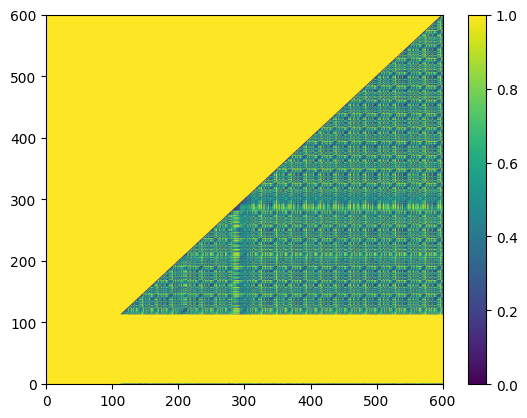

In [95]:
#remove future events from SSM
ssm_causal = ssm
for i in range(ssm.shape[0]):
    ssm_causal[i,:i]=0

dssm = 1-ssm_causal #dissimilarity matrix
plt.imshow(dssm,origin='lower',aspect='auto')
plt.colorbar()
plt.show()

In [96]:
ssm_causal = dssm
nov = np.zeros(ssm_causal.shape[0])
scales=np.zeros_like(nov)
contrasts=np.zeros_like(nov)
#at each time t 
for t in range(1,ssm_causal.shape[0]):
    #check the lines below t to asses temporal scale
    for i in range(1,t+1):
        s_t=ssm_causal[t-i,t]
        
        #1) check if ssm(t-i,t)<ssm(t-i,t-1) 
        if s_t>=ssm_causal[t-i,t-1]: 
            #print(s_t,ssm_causal[t-i,t-1])
            break 
        #2) check if ssm(t,t)<mean(line)-2*std(line)
        line = ssm_causal[t-i,t-i:t]
        mu, std = np.mean(line), np.std(line)
        
        
        if s_t >= mu - 2*std : 
            #print("s_t",s_t,", mean - 2*std:",mu-2*std)
            break
    
    #print(t,i)
    t_scale=i
    c_prev = ssm_causal[t-1-i:t-1,t-1]
    c = ssm_causal[t-1-i:t-1,t]
    contrast = np.linalg.norm(c-c_prev,ord=1)
    #print(f"scale and contrast at time {t} : {t_scale}, {contrast}")
    
    nov[t]=contrast #the novelty curve is the contrast between the two columns t-1 and t in the range of the temporal scale
    scales[t]=t_scale
    contrasts[t]=contrast

#normalize score
nov = (nov-min(nov))/(max(nov)-min(nov))
#apply filter
b, a = signal.butter(3,0.05) #3rd order butterworth lowpass filter of cutoff frequency 0.05*f_nyquist (?)
nov_filt = np.clip(signal.filtfilt(b,a,nov),a_min=0,a_max=None)

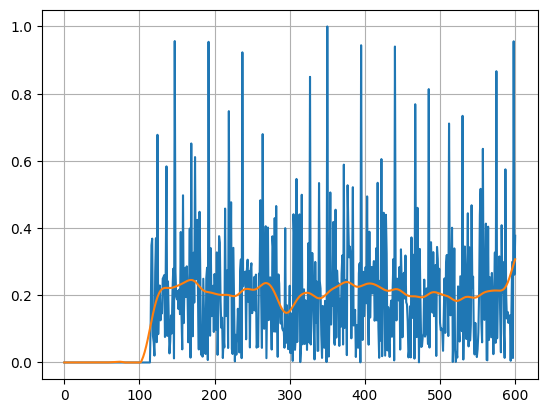

In [97]:
# plt.plot(scales)
# plt.plot(contrasts)
plt.plot(nov)
plt.plot(nov_filt)
plt.grid()
plt.show()

0.5332872524132455


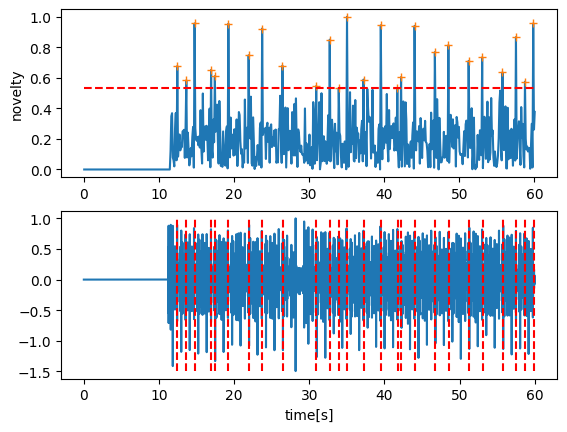

In [ ]:
mu, std = np.mean(nov), np.std(nov)
thresh = mu+2*std
print(thresh)
min_segment_duration = 0.5 #minimum sample length is 50ms
peaks, _ = find_peaks(nov, height=thresh, distance=time_to_frames(min_segment_duration,sr=sr,hop_length=w_size,n_fft=w_size))
t = frames_to_time(range(len(ssm_causal)),sr=sr,hop_length=w_size,n_fft=w_size)

plt.subplot(211)
plt.plot(t,nov)
plt.plot(t[peaks], nov[peaks], "+")
plt.hlines(thresh,0,t[-1],colors="r",linestyles="--")
plt.ylabel("novelty")
#plt.xlim(60,80)
plt.subplot(212)
plt.plot(np.linspace(0,len(y)/sr,len(y)),y)
plt.vlines(t[peaks],min(y),max(y),colors="r",linestyles="--")
plt.xlabel("time[s]")
#plt.xlim(60,80)
plt.show()

In [58]:
click=clicks(times=t[peaks],sr=sr, length=len(y))
y_click = click+y
display(Audio(y_click,rate=sr))

In [59]:
def non_maximum_suppression_1d(peaks, values, delta):
    """
    Keep only the maximum peak within a neighborhood of ±delta.

    Parameters:
    - peaks: array of peak indices (e.g., from find_peaks)
    - values: array of novelty values at those peak indices
    - delta: minimum distance (in samples) between accepted peaks

    Returns:
    - suppressed_peaks: filtered list of peak indices
    """
    if len(peaks) == 0:
        return []

    # Sort peaks by descending value
    order = np.argsort(values[peaks])[::-1]
    selected = []
    suppressed = np.zeros(len(peaks), dtype=bool)

    for i in order:
        if suppressed[i]:
            continue
        p = peaks[i]
        selected.append(p)

        # Suppress all peaks within ±delta
        for j in range(len(peaks)):
            if not suppressed[j] and abs(peaks[j] - p) <= delta:
                suppressed[j] = True

    return np.array(sorted(selected))


## algo de detection vient de https://stackoverflow.com/questions/22583391/peak-signal-detection-in-realtime-timeseries-data

In [99]:
#peak detection algorithm
#compute a moving average on a window of size L
#find peaks by evaluating if a new point is above a threshold T from the moving average
#the moving average is update each new point with an update influence I

L = 20 #controle la taille de la fenetre pour la moyenne mouvante. si le signal est "stationaire" (moyenne et avraince cte) mettre une grande valeur de lag
I = 0. #influence : l'influence des nouveaux points pour la mise a jour des parametres du signal filtré (mu, std) et qui determine le
T = 4

filteredY = nov[:L].tolist()
avgFilter = [np.mean(nov[:L])]*L
stdFilter = [np.std(nov[:L])]*L

peaks = []

for i in range(L,len(nov)):
    if abs(nov[i]-avgFilter[i-1]) > T*stdFilter[i-1]:
        #peak detected at timestep i
        peaks.append(i) 
        #update moving average
        filteredY.append(I*nov[i]+(1-I)*filteredY[i-1])
    else :
        filteredY.append(nov[i])#(I*nov[i]+(1-I)*filteredY[i-1])
    
    avgFilter.append(np.mean(filteredY[-L:]))
    stdFilter.append(np.std(filteredY[-L:]))
    
#clean peaks
peaks_values = nov[peaks]
cleaned_peaks = non_maximum_suppression_1d(peaks, nov,5)
    

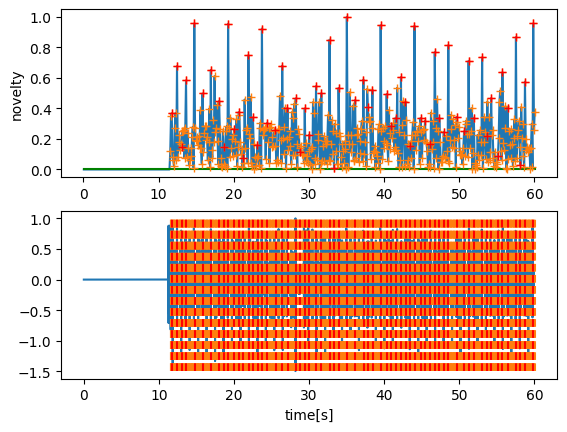

In [100]:
plt.subplot(211)
plt.plot(t,nov)
plt.plot(t,filteredY,"g")
plt.plot(t[peaks], nov[peaks], "+")
plt.plot(t[cleaned_peaks], nov[cleaned_peaks], "r+")
plt.ylabel("novelty")
#plt.xlim(60,80)
plt.subplot(212)
plt.plot(np.linspace(0,len(y)/sr,len(y)),y)
plt.vlines(t[peaks],min(y),max(y),colors="tab:orange",linestyles="--")
plt.vlines(t[cleaned_peaks],min(y),max(y),colors="r",linestyles="--")
plt.xlabel("time[s]")
#plt.xlim(60,80)
plt.show()

In [64]:
click=clicks(times=t[cleaned_peaks],sr=sr, length=len(y))
y_click = click+y
display(Audio(y_click,rate=sr))

In [88]:
cleaned_peaks_samples = frames_to_samples(cleaned_peaks,hop_length=w_size,n_fft=w_size)
cleaned_peaks_samples = np.concatenate([[0],cleaned_peaks_samples])
segments = [y[t0:t1] for t0,t1 in zip(cleaned_peaks_samples[:-1],cleaned_peaks_samples[1:])]

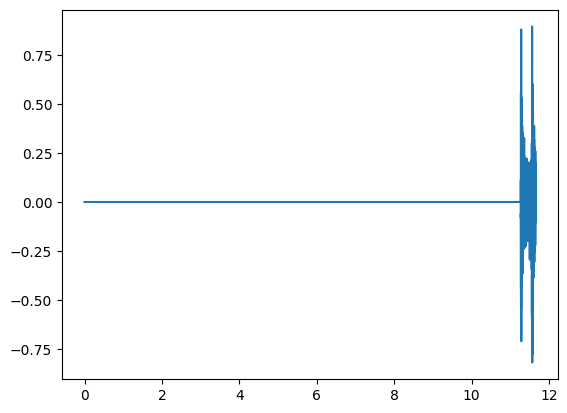

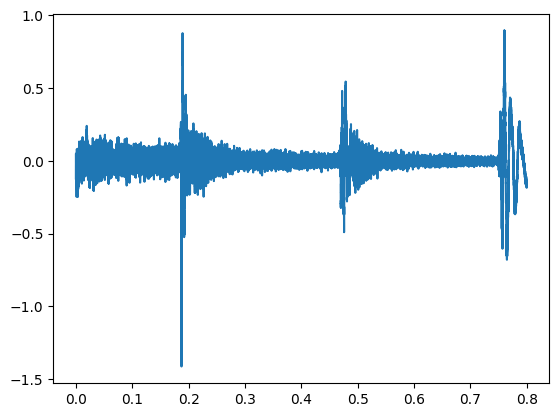

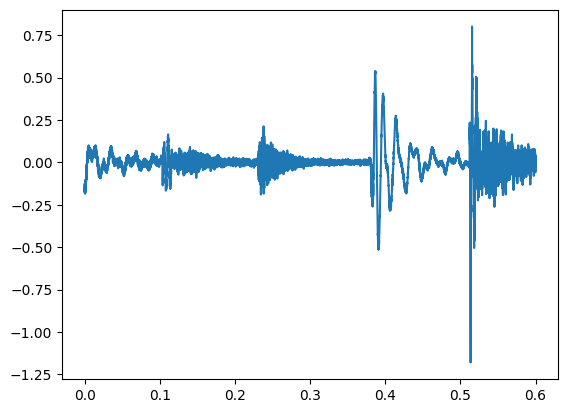

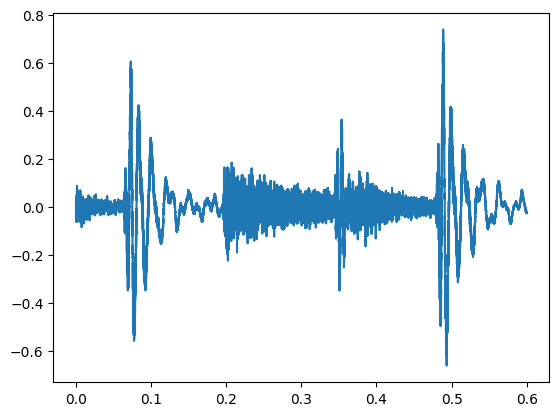

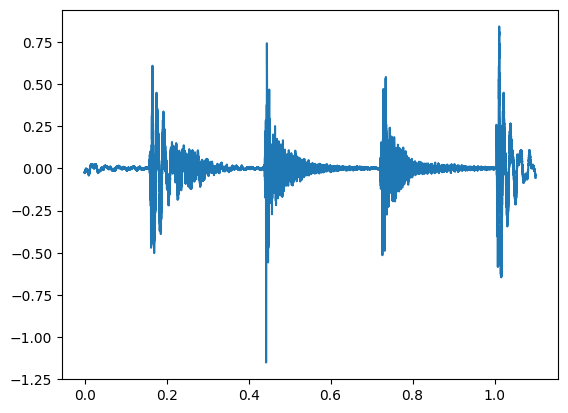

...

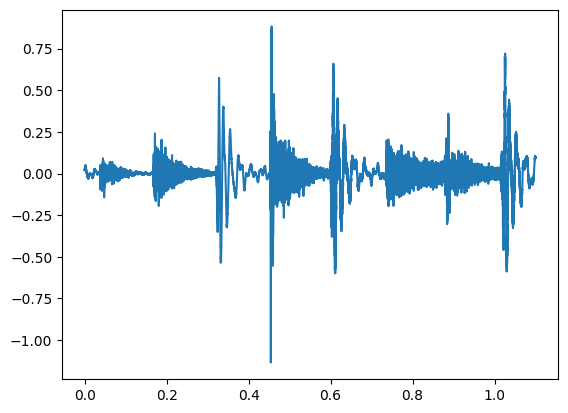

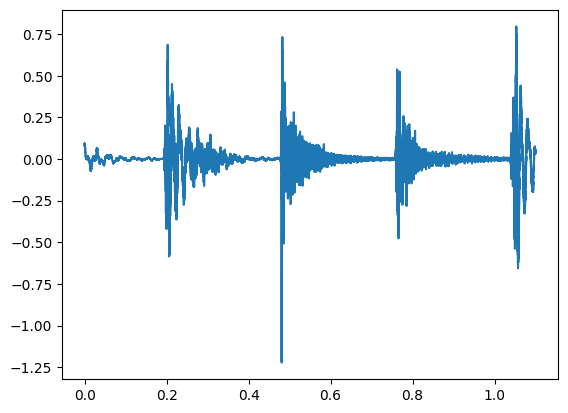

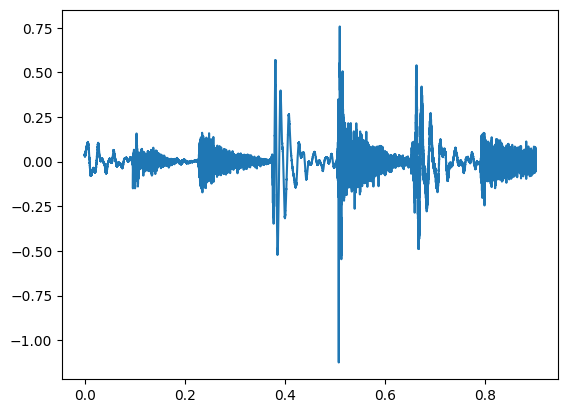

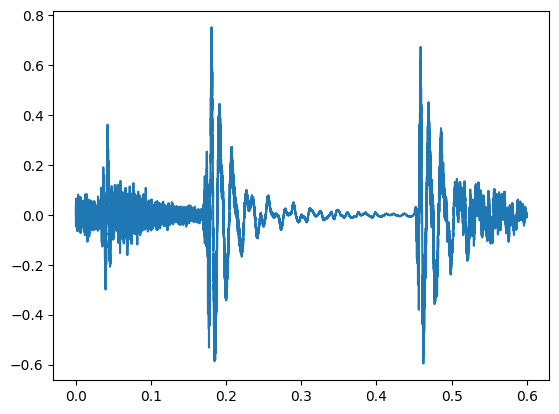

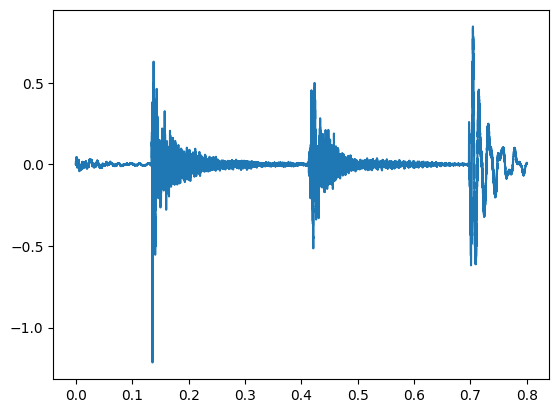

In [91]:
for segment in segments:
    t_ = np.linspace(0,len(segment)/sr,len(segment))
    plt.plot(t_,segment)
    plt.show()
    display(Audio(segment,rate=sr))

## Test class

In [2]:
from src.segmentation import MultiGranularSegmentation

In [3]:
fname="../../train_subset/014f3712-293b-42af-9f29-0ed1785be792/drums/drums.wav"
#fname="/data3/anasynth_nonbp/bujard/data/moisesdb_v2/train_subset/0358fd1e-244a-4422-9a42-29b5d68f6e4b/other_keys/other_keys.wav"
y, sr = load(fname,sr=None,mono=True,duration=60)
y = y/max(y)

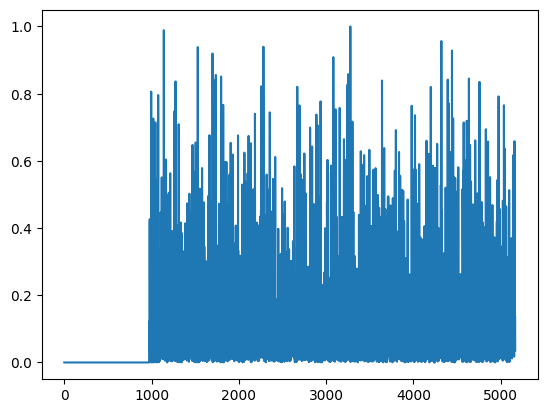

In [5]:
n_fft = 512
mgsegment = MultiGranularSegmentation(sr, n_fft, "robust")

nov, scales = mgsegment.compute_novelty(y)
nov = (nov-min(nov))/(max(nov)-min(nov))

plt.plot(nov)

peaks = mgsegment.find_peaks(nov)
#segments = mgsegment.segment(y)

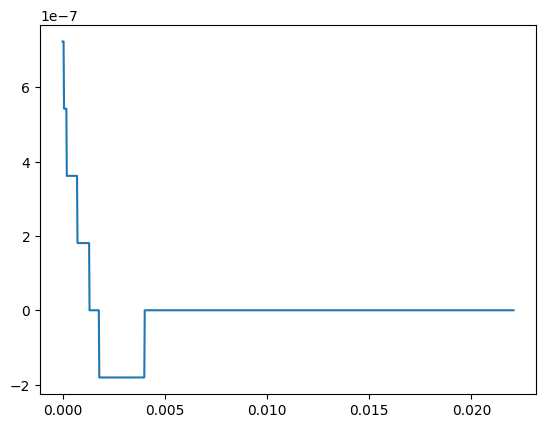

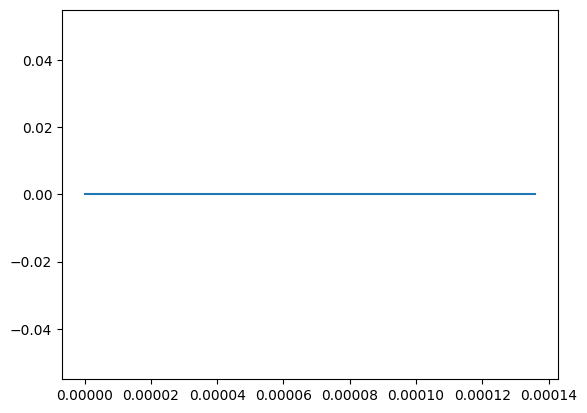

/opt/anaconda3/envs/dicy2_env/lib/python3.10/site-packages/IPython/lib/display.py:187: RuntimeWarning: invalid value encountered in divide
  scaled = data / normalization_factor * 32767
/opt/anaconda3/envs/dicy2_env/lib/python3.10/site-packages/IPython/lib/display.py:188: RuntimeWarning: invalid value encountered in cast
  return scaled.astype("<h").tobytes(), nchan


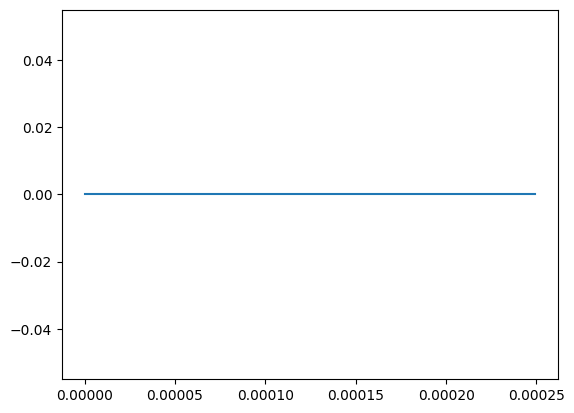

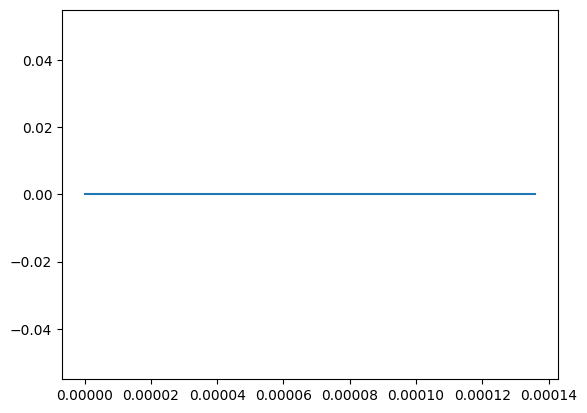

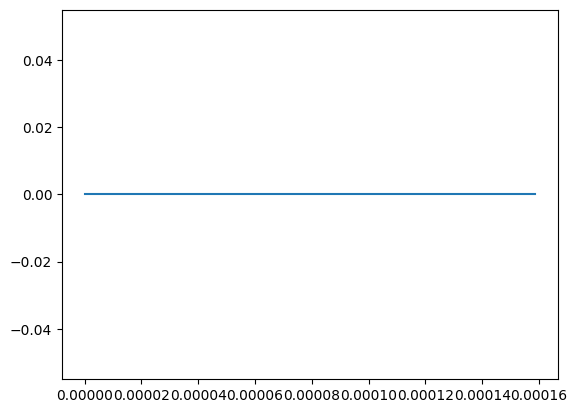

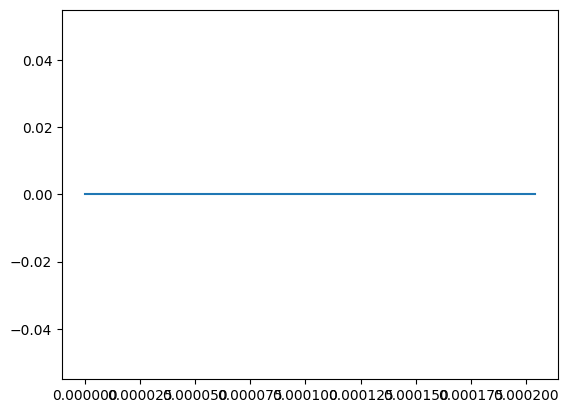

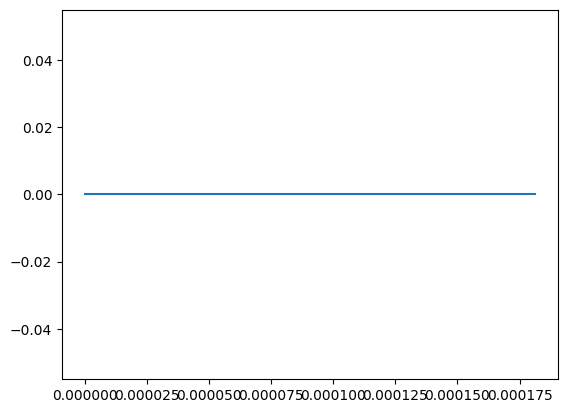

...

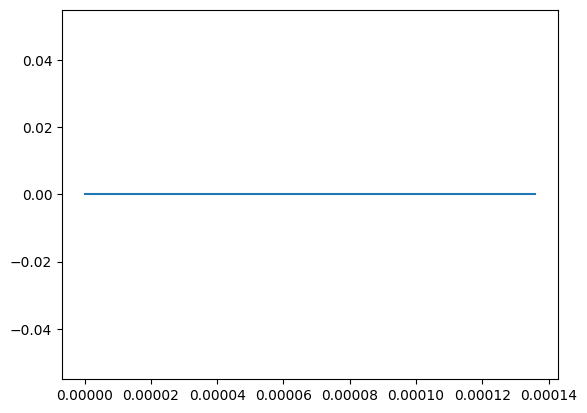

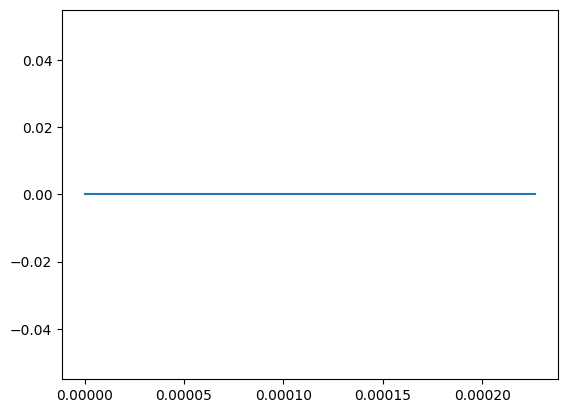

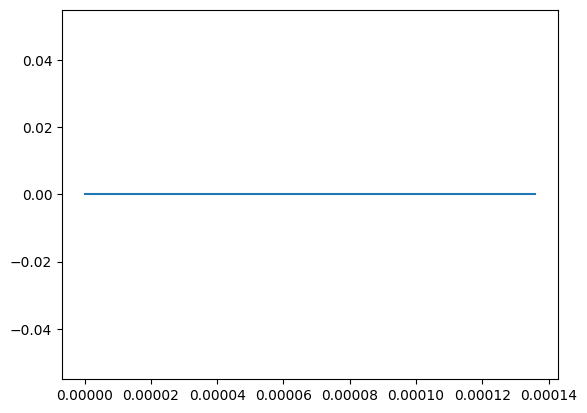

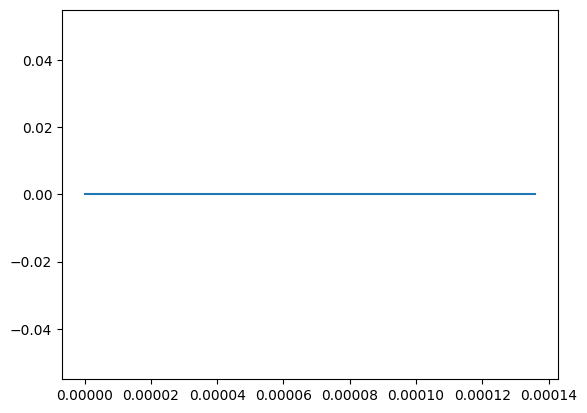

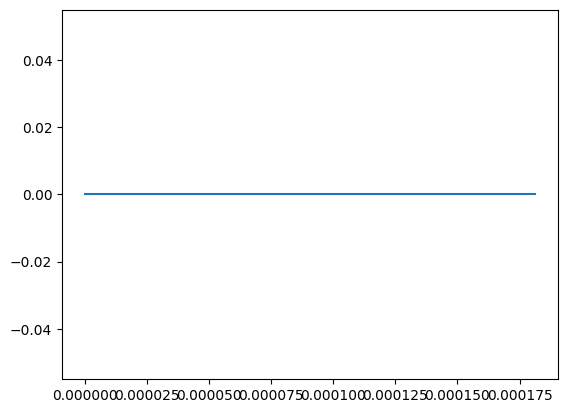

In [5]:
for segment in segments:
    t_ = np.linspace(0,len(segment)/sr,len(segment))
    plt.plot(t_,segment)
    plt.show()
    display(Audio(segment,rate=sr))